In [60]:
import numpy as np
from scipy import stats
import os
from os.path import join
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import sklearn

In [109]:
DIR = '/scratch/richardso21/20-21_BGSUB/archive/FgSegNet_O_old/200'
SITES = ['prudhoe_12', 'prudhoe_15', 'prudhoe_22']

In [110]:
PDIR = join(DIR, SITES[0], 'pos')
NDIR = join(DIR, SITES[0], 'neg')

In [111]:
PDIR

'/scratch/richardso21/20-21_BGSUB/archive/FgSegNet_O_old/200/prudhoe_12/pos'

In [112]:
pmaxesl = []
ptotalsl = []
nmaxesl = []
ntotalsl = []

In [113]:
for fn in tqdm(os.listdir(PDIR)):
    full_fn = join(PDIR, fn)
    npy = np.load(full_fn)
    pmaxesl.append(np.max(npy))
    ptotalsl.append(np.sum(npy))

for fn in tqdm(os.listdir(NDIR)):
    full_fn = join(NDIR, fn)
    npy = np.load(full_fn)
    nmaxesl.append(np.max(npy))
    ntotalsl.append(np.sum(npy))

100%|██████████| 1867/1867 [01:37<00:00, 19.15it/s]


---

In [114]:
pmaxes = np.array(pmaxesl)
ptotals = np.array(ptotalsl)
nmaxes = np.array(nmaxesl)
ntotals = np.array(ntotalsl)

In [115]:
ptotalsz = np.delete(ptotals, np.where(np.abs(stats.zscore(ptotals) > 2)))
ntotalsz = np.delete(ntotals, np.where(np.abs(stats.zscore(ntotals) > 2)))

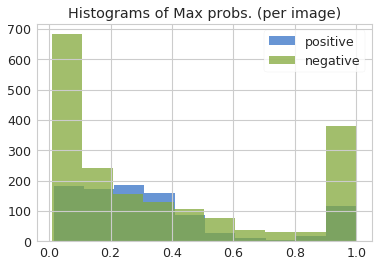

In [116]:
plt.hist(pmaxes, alpha=0.75, label='positive')
plt.hist(nmaxes, alpha=0.75, label='negative')
# plt.show()
plt.title('Histograms of Max probs. (per image)')
plt.legend()
plt.savefig('hist_pos_neg_max.png')

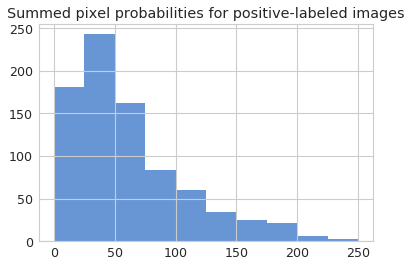

In [17]:
plt.hist(ptotalsz, range=(0,250), alpha=0.75)
plt.title('Summed pixel probabilities for positive-labeled images')
plt.savefig('hist_pos_sum.png')

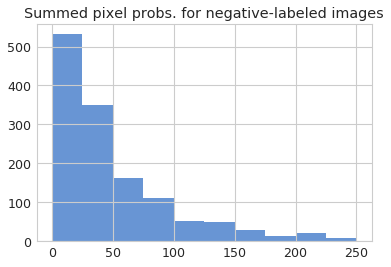

In [18]:
plt.hist(ntotalsz, range=(0,250), alpha=0.75)
plt.title('Summed pixel probs. for negative-labeled images')
plt.savefig('hist_neg_sum.png')

---

In [25]:
pind = np.argpartition(ptotals, -50)[-50:]
nind = np.argpartition(ntotals, -50)[-50:]

In [28]:
ptotals[pind]

array([  3569.1016,   3646.7615,   3725.4412,   4395.9365,   6495.3574,
         4192.375 ,   4412.5513,   4950.3457,   5387.988 ,   3958.1704,
         8246.258 ,   6265.999 ,   5184.205 ,   5031.8438,   6186.602 ,
         5915.162 ,   7959.5776,   4702.8022,   5180.5703,   4242.7993,
         3729.45  ,   6853.568 ,   8423.189 ,  82543.88  , 138565.12  ,
        18335.807 ,  59755.3   ,  12226.234 ,  83521.48  ,  18535.877 ,
       114296.586 ,  50706.477 ,  12697.356 , 127987.78  ,  17019.04  ,
        94894.28  , 258329.9   ,  42141.93  ,  31315.734 ,  58249.34  ,
        15693.028 ,  15272.608 ,  68469.25  ,  33102.918 ,  70994.08  ,
       112309.58  ,  11713.887 ,   8770.337 ,  66760.266 ,  39788.668 ],
      dtype=float32)

In [29]:
ntotals[nind]

array([ 62374.69 ,  63010.973,  71900.51 ,  67202.25 ,  73441.836,
        77472.5  , 137874.14 , 124059.31 , 137244.7  , 109329.97 ,
        95440.266, 128152.414,  75066.445, 138726.39 , 140417.88 ,
        75561.82 , 112932.4  , 110484.72 , 144407.58 , 416517.56 ,
       156905.52 , 160754.05 , 169706.53 , 151958.31 , 191345.22 ,
       155977.23 , 236302.25 , 162855.3  , 187964.28 , 183628.31 ,
       434098.44 , 253051.6  , 152585.28 , 296172.88 , 251247.3  ,
       184828.38 , 188881.47 , 171568.61 , 329057.   , 422833.72 ,
       367896.   , 355374.2  , 191518.77 , 251787.17 , 206806.02 ,
       171558.6  , 359416.97 , 368401.34 , 197941.17 , 373024.3  ],
      dtype=float32)

In [57]:
TEST = '/scratch/richardso21/20-21_BGSUB/FgSegNet_Test/prudhoe_12/'

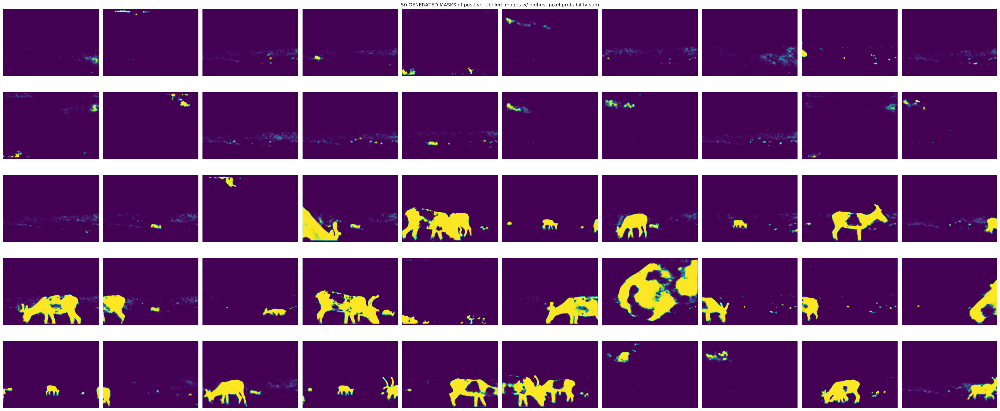

In [71]:
pFns = os.listdir(PDIR)
sel_pFns = []
mask_fig_pos = plt.figure(figsize=(35, 15), dpi=120)
for i, ind in enumerate(pind):
    plt.subplot(5, 10, (i+1))
    sel_pFns.append(pFns[ind])
    load = np.load(join(PDIR, pFns[ind]))
    plt.imshow(load)
    plt.axis('off')
mask_fig_pos.tight_layout()
mask_fig_pos.suptitle('50 GENERATED MASKS of positive-labeled images w/ highest pixel probability sum')
mask_fig_pos.show()
mask_fig_pos.savefig('comp_preds_50pos_maxsum.png')

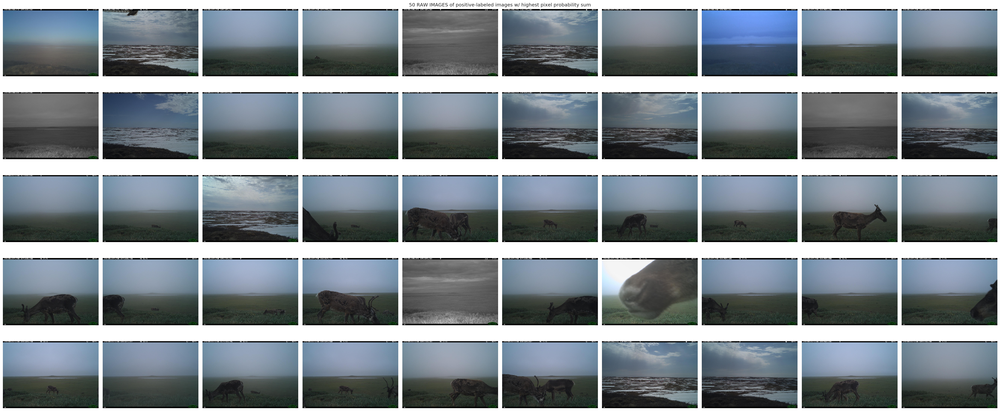

In [74]:
raw_fig_pos = plt.figure(figsize=(35, 15), dpi=120)
# rawpFns = join(TEST, 'pos')
for i, raw_sel in enumerate(sel_pFns):
    plt.subplot(5, 10, (i + 1))
    load = mpimg.imread(join(TEST, 'pos', raw_sel).replace('.npy', '.JPG'))
    plt.imshow(load)
    plt.axis('off')
raw_fig_pos.tight_layout()
raw_fig_pos.suptitle('50 RAW IMAGES of positive-labeled images w/ highest pixel probability sum')
raw_fig_pos.show()
raw_fig_pos.savefig('comp_raw_50pos_maxsum.png')

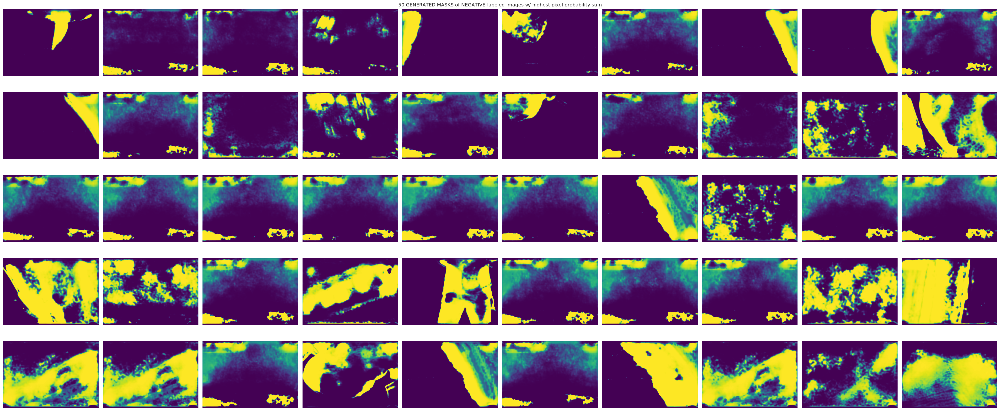

In [73]:
nFns = os.listdir(NDIR)
sel_nFns = []
mask_fig_neg = plt.figure(figsize=(35, 15), dpi=120)
for i, ind in enumerate(nind):
    plt.subplot(5, 10, (i+1))
    sel_nFns.append(nFns[ind])
    load = np.load(join(NDIR, nFns[ind]))
    plt.imshow(load)
    plt.axis('off')
mask_fig_neg.tight_layout()
mask_fig_neg.suptitle('50 GENERATED MASKS of NEGATIVE-labeled images w/ highest pixel probability sum')
mask_fig_neg.show()
mask_fig_neg.savefig('comp_preds_50neg_maxsum.png')

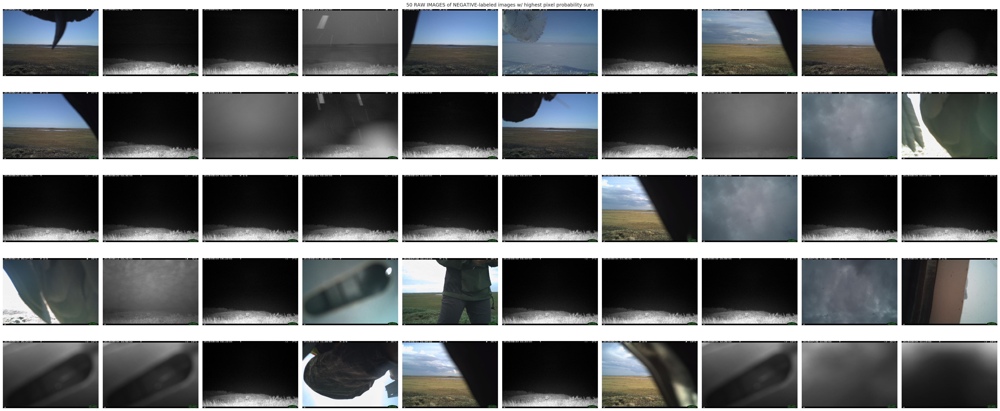

In [79]:
raw_fig_neg = plt.figure(figsize=(35, 15), dpi=120)
# rawpFns = join(TEST, 'pos')
for i, raw_sel in enumerate(sel_nFns):
    plt.subplot(5, 10, (i + 1))
    load = mpimg.imread(join(TEST, 'neg', raw_sel).replace('.npy', '.JPG'))
    plt.imshow(load)
    plt.axis('off')
raw_fig_neg.tight_layout()
raw_fig_neg.suptitle('50 RAW IMAGES of NEGATIVE-labeled images w/ highest pixel probability sum')
raw_fig_neg.show()
raw_fig_neg.savefig('comp_raw_50neg_maxsum.png')

---

In [408]:
from sklearn.model_selection import train_test_split

In [409]:
X = np.stack([np.concatenate([ptotals, ntotals]), np.concatenate([pmaxes, nmaxes])], axis=1)

In [410]:
y = np.concatenate([np.ones(len(ptotals)), np.zeros(len(ntotals))])

In [412]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=42)

In [413]:
from sklearn import linear_model
from sklearn import svm

In [434]:
clf = svm.SVC(kernel='linear')
clf.fit(X_train, y_train)

SVC(kernel='linear')

In [435]:
clf.score(X_test, y_test)

0.6116504854368932

In [436]:
clf.predict(X_test)

array([0., 1., 1., 1., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 1., 0., 1.,
       0., 1., 0., 1., 0., 0., 1., 1., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 1., 0., 0., 0., 1., 1., 0., 0., 0., 0., 0., 1., 0.,
       1., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0., 1., 0.,
       0., 0., 0., 1., 0., 1., 1., 0., 0., 1., 1., 1., 1., 0., 0., 0., 0.,
       1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0.,
       0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 1., 0., 0., 0., 0., 0.,
       1., 0., 0., 1., 0., 1., 0., 0., 0., 0., 1., 0., 1., 0., 0., 1., 1.,
       0., 1., 0., 1., 0., 0., 0., 1., 1., 1., 0., 0., 0., 0., 0., 1., 1.,
       0., 1., 0., 0., 0., 0., 0., 0., 1., 0., 0., 1., 1., 0., 0., 0., 0.,
       0., 1., 0., 0., 1., 1., 0., 0., 0., 0., 0., 1., 1., 0., 0., 1., 0.,
       1., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 1., 0.,
       0., 0., 1., 0., 0., 0., 0., 0., 0., 1., 0., 0., 0., 0., 1., 0., 0.,
       0., 0., 0., 0., 0.

---

In [81]:
PDIR = join(DIR, SITES[1], 'pos')
NDIR = join(DIR, SITES[1], 'neg')

In [82]:
PDIR

'/scratch/richardso21/20-21_BGSUB/FgSegNet_O/200/prudhoe_15/pos'

In [83]:
os.listdir(PDIR)

['2019_101RECNX_RCNX5004.npy',
 '2019_Summer_100RECNX_RCNX5696.npy',
 '2019_100RECNX_RCNX7283.npy',
 '2019_Summer_100RECNX_RCNX5581.npy',
 '2019_100RECNX_RCNX1656.npy',
 '2019_100RECNX_RCNX2428.npy',
 '2019_Summer_100RECNX_RCNX5959.npy',
 '2019_Summer_100RECNX_RCNX5988.npy',
 '2019_Summer_100RECNX_RCNX7796.npy',
 '2019_100RECNX_RCNX7066.npy',
 '2019_Summer_100RECNX_RCNX5473.npy',
 '2019_100RECNX_RCNX6867.npy',
 '2019_Summer_100RECNX_RCNX5691.npy',
 '2019_Summer_100RECNX_RCNX6023.npy',
 '2019_100RECNX_RCNX6074.npy',
 '2019_100RECNX_RCNX7284.npy',
 '2019_Summer_100RECNX_RCNX4158.npy',
 '2019_100RECNX_RCNX4218.npy',
 '2019_101RECNX_RCNX4985.npy',
 '2019_Summer_100RECNX_RCNX5957.npy',
 '2019_101RECNX_RCNX5862.npy',
 '2019_100RECNX_RCNX5113.npy',
 '2019_Summer_100RECNX_RCNX5986.npy',
 '2019_Summer_100RECNX_RCNX7798.npy',
 '2019_100RECNX_RCNX5889.npy',
 '2019_100RECNX_RCNX1534.npy',
 '2019_Summer_100RECNX_RCNX4156.npy',
 '2019_100RECNX_RCNX8975.npy',
 '2019_Summer_100RECNX_RCNX4290.npy',
 '2

In [84]:
pmaxesl = []
ptotalsl = []
nmaxesl = []
ntotalsl = []

In [85]:
for fn in tqdm(os.listdir(PDIR)):
    full_fn = join(PDIR, fn)
    npy = np.load(full_fn)
    pmaxesl.append(np.max(npy))
    ptotalsl.append(np.sum(npy))

for fn in tqdm(os.listdir(NDIR)):
    full_fn = join(NDIR, fn)
    npy = np.load(full_fn)
    nmaxesl.append(np.max(npy))
    ntotalsl.append(np.sum(npy))

100%|██████████| 1024/1024 [00:46<00:00, 21.81it/s]


In [86]:
pmaxes = np.array(pmaxesl)
ptotals = np.array(ptotalsl)
nmaxes = np.array(nmaxesl)
ntotals = np.array(ntotalsl)

In [87]:
# for i in [ptotals, ntotals]:
#     i = np.delete(i, np.where(np.abs(stats.zscore(i)) > 3))
ptotalsz = np.delete(ptotals, np.where(np.abs(stats.zscore(ptotals) > 2)))
ntotalsz = np.delete(ntotals, np.where(np.abs(stats.zscore(ntotals) > 2)))

In [88]:
max(ptotals) , max(ntotals)

(302243.34, 367193.12)

In [89]:
max(ptotalsz) , max(ntotalsz)

(44778.49, 74561.88)

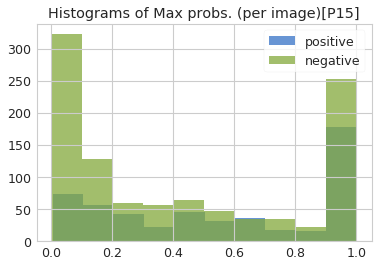

In [90]:
plt.hist(pmaxes, alpha=0.75, label='positive')
plt.hist(nmaxes, alpha=0.75, label='negative')
# plt.show()
plt.title('Histograms of Max probs. (per image)[P15]')
plt.legend()
plt.savefig('hist_pos_neg_max_prudhoe15.png')

Text(0.5, 1.0, 'Summed pixel probabilities for positive-labeled images[P15]')

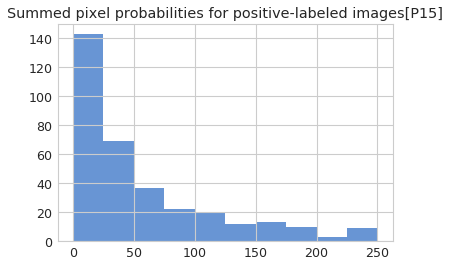

In [93]:
plt.hist(ptotalsz, range=(0,250), alpha=0.75)
plt.title('Summed pixel probabilities for positive-labeled images[P15]')
# plt.savefig('hist_pos_sum_prudhoe15.png')

Text(0.5, 1.0, 'Summed pixel probs. for negative-labeled images[P15]')

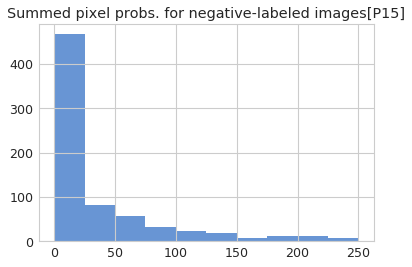

In [94]:
plt.hist(ntotalsz, range=(0,250), alpha=0.75)
plt.title('Summed pixel probs. for negative-labeled images[P15]')
# plt.savefig('hist_neg_sum_prudhoe15.png')

In [95]:
TEST = '/scratch/richardso21/20-21_BGSUB/FgSegNet_Test/prudhoe_15/'

In [102]:
pind = np.argpartition(ptotals, -50)[-50:]
nind = np.argpartition(ntotals, -50)[-50:]

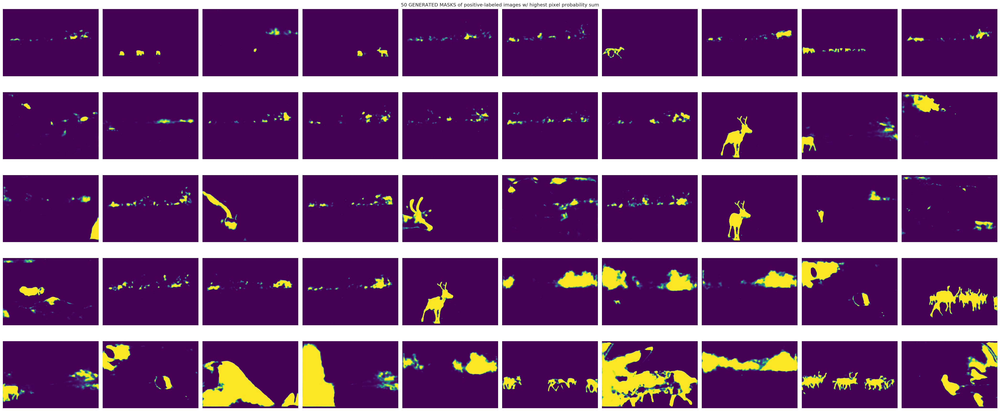

In [103]:
pFns = os.listdir(PDIR)
sel_pFns = []
mask_fig_pos = plt.figure(figsize=(35, 15), dpi=120)
for i, ind in enumerate(pind):
    plt.subplot(5, 10, (i+1))
    sel_pFns.append(pFns[ind])
    load = np.load(join(PDIR, pFns[ind]))
    plt.imshow(load)
    plt.axis('off')
mask_fig_pos.tight_layout()
mask_fig_pos.suptitle('50 GENERATED MASKS of positive-labeled images w/ highest pixel probability sum')
mask_fig_pos.show()
# mask_fig_pos.savefig('comp_preds_50pos_maxsum.png')

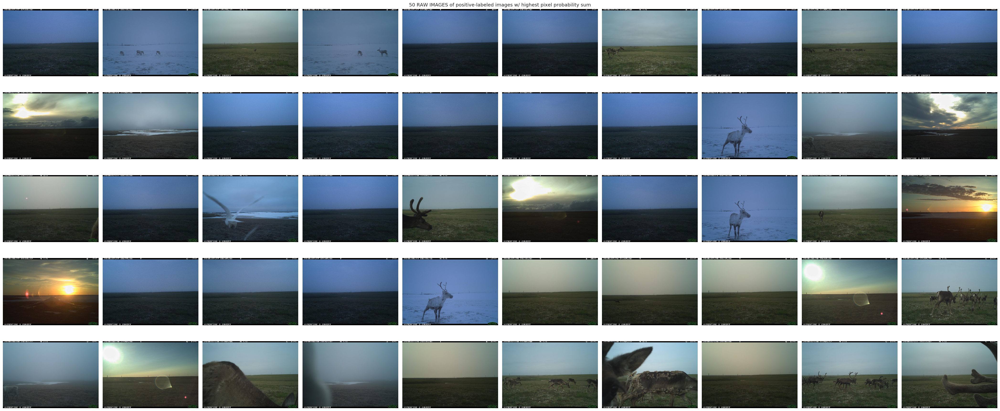

In [104]:
raw_fig_pos = plt.figure(figsize=(35, 15), dpi=120)
# rawpFns = join(TEST, 'pos')
for i, raw_sel in enumerate(sel_pFns):
    plt.subplot(5, 10, (i + 1))
    load = mpimg.imread(join(TEST, 'pos', raw_sel).replace('.npy', '.JPG'))
    plt.imshow(load)
    plt.axis('off')
raw_fig_pos.tight_layout()
raw_fig_pos.suptitle('50 RAW IMAGES of positive-labeled images w/ highest pixel probability sum')
raw_fig_pos.show()
# raw_fig_pos.savefig('comp_raw_50pos_maxsum.png')

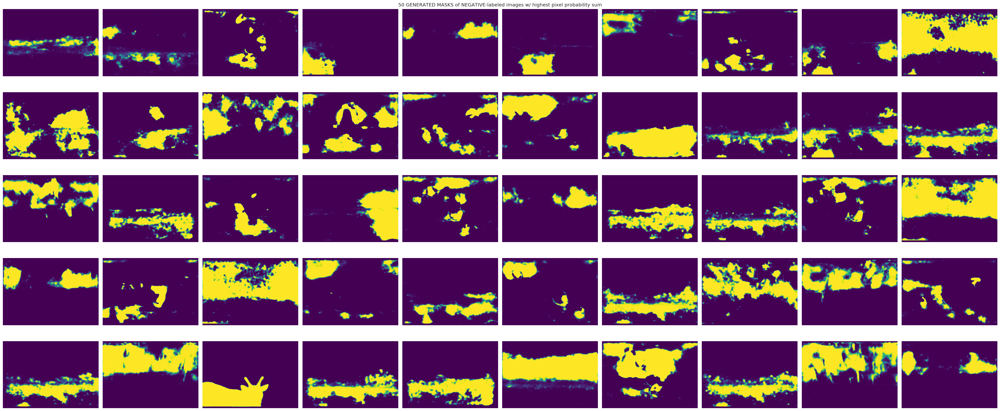

In [105]:
nFns = os.listdir(NDIR)
sel_nFns = []
mask_fig_neg = plt.figure(figsize=(35, 15), dpi=120)
for i, ind in enumerate(nind):
    plt.subplot(5, 10, (i+1))
    sel_nFns.append(nFns[ind])
    load = np.load(join(NDIR, nFns[ind]))
    plt.imshow(load)
    plt.axis('off')
mask_fig_neg.tight_layout()
mask_fig_neg.suptitle('50 GENERATED MASKS of NEGATIVE-labeled images w/ highest pixel probability sum')
mask_fig_neg.show()
# mask_fig_neg.savefig('comp_preds_50neg_maxsum.png')

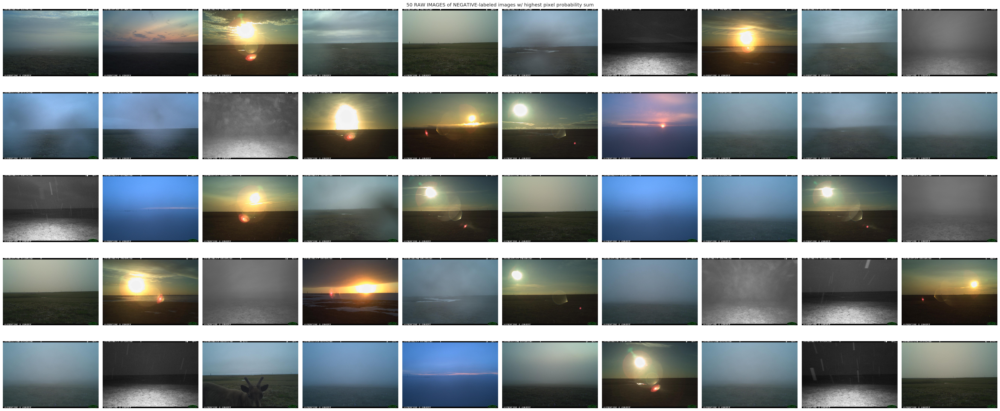

In [106]:
raw_fig_neg = plt.figure(figsize=(35, 15), dpi=120)
# rawpFns = join(TEST, 'pos')
for i, raw_sel in enumerate(sel_nFns):
    plt.subplot(5, 10, (i + 1))
    load = mpimg.imread(join(TEST, 'neg', raw_sel).replace('.npy', '.JPG'))
    plt.imshow(load)
    plt.axis('off')
raw_fig_neg.tight_layout()
raw_fig_neg.suptitle('50 RAW IMAGES of NEGATIVE-labeled images w/ highest pixel probability sum')
raw_fig_neg.show()
# raw_fig_neg.savefig('comp_raw_50neg_maxsum.png')